
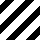
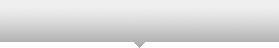
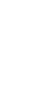
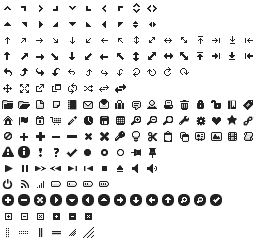
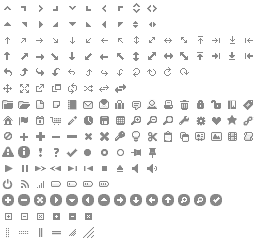
...
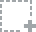
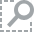
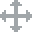
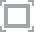
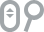

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline  
import pandas as pd
import numpy as np
import scipy as sp
import datetime
import glob
import bokeh.plotting as bkh
bkh.output_notebook()
import sys;
sys.path.append("/home/liuzhenya/rosbag_python_analysis")
import bisect
pd.set_option('display.mpl_style', 'default') # Make the graphs a bit prettier
plt.rcParams['figure.figsize'] = (5, 5)
import rosbag_pandas
import rosbag
import csv

In [6]:
def search_txt(folder_path):
    txtlist = []
    compare_txt = []
    i = 0
    for filename in glob.glob(folder_path + '*.bag'):
            #print index,filename
            txtlist.append(filename)
    return txtlist
txtlist = search_txt('/media/liuzhenya/NewDisk/10.30/')
txtlist.sort()
for index,filename in enumerate(txtlist):
    print index,filename

0 /media/liuzhenya/NewDisk/10.30/2015-10-30-16-39-49.bag


In [20]:
#f = rosbag_pandas.bag_to_dataframe("/media/liuzhenya/NewDisk/2015-10-20-14-53-53_novelodyne.bag")
bagname = txtlist[0]
yaml = rosbag_pandas.get_bag_info(bagname)
topics = rosbag_pandas.get_topics(yaml)
topics = filter(lambda x: x.endswith('10/Odometry') or x.endswith('data/Odometry'),topics)
#topics = filter(lambda x: x.endswith('100/Odometry'),topics)
msgs,msgtype=rosbag_pandas.get_msg_info(yaml,topics)
msgname = rosbag_pandas.create_data_map(msgs)
dataf={}
for topic in topics:
    dataf[topic] = rosbag_pandas.bag_to_dataframe(bagname,include=topic,seconds=True)
colors=['red','orange','black','yellow','aqua','black']
comp = ['pose.pose.position.x', 'pose.pose.position.y','twist.twist.linear.x', 'twist.twist.linear.y']
p = bkh.figure(title=comp[0], x_axis_label='time', y_axis_label='diff_x/dt(m/s)',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic].index,np.diff(dataf[topic][msgname[topic][comp[0]]])/np.diff(dataf[topic].index),line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)
p = bkh.figure(title=comp[2], x_axis_label='time', y_axis_label='vx(m/s)',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic].index,dataf[topic][msgname[topic][comp[2]]],line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)
p = bkh.figure(title=comp[1], x_axis_label='time', y_axis_label='diff_y/dt(m/s)',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic].index,np.diff(dataf[topic][msgname[topic][comp[1]]])/np.diff(dataf[topic].index),line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)
p = bkh.figure(title=comp[3], x_axis_label='time', y_axis_label='vy(m/s)',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic].index,dataf[topic][msgname[topic][comp[3]]],line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)
p = bkh.figure(title="position", x_axis_label='x', y_axis_label='y',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic][msgname[topic][comp[0]]],dataf[topic][msgname[topic][comp[1]]],line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)

In [21]:
bagname = txtlist[0]
yaml = rosbag_pandas.get_bag_info(bagname)
topics = rosbag_pandas.get_topics(yaml)
topics = filter(lambda x: x.endswith('100/Odometry') or x.endswith('data/Odometry'),topics)
#topics = filter(lambda x: x.endswith('100/Odometry'),topics)
msgs,msgtype=rosbag_pandas.get_msg_info(yaml,topics)
msgname = rosbag_pandas.create_data_map(msgs)
dataf={}
for topic in topics:
    dataf[topic] = rosbag_pandas.bag_to_dataframe(bagname,include=topic,seconds=True)
colors=['red','orange','black','yellow','aqua','black']
comp = ['pose.pose.position.x', 'pose.pose.position.y','twist.twist.linear.x', 'twist.twist.linear.y']
p = bkh.figure(title=comp[0], x_axis_label='time', y_axis_label='diff_x/dt(m/s)',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic].index,np.diff(dataf[topic][msgname[topic][comp[0]]])/np.diff(dataf[topic].index),line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)
p = bkh.figure(title=comp[2], x_axis_label='time', y_axis_label='vx(m/s)',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic].index,dataf[topic][msgname[topic][comp[2]]],line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)
p = bkh.figure(title=comp[1], x_axis_label='time', y_axis_label='diff_y/dt(m/s)',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic].index,np.diff(dataf[topic][msgname[topic][comp[1]]])/np.diff(dataf[topic].index),line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)
p = bkh.figure(title=comp[3], x_axis_label='time', y_axis_label='vy(m/s)',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic].index,dataf[topic][msgname[topic][comp[3]]],line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)
p = bkh.figure(title="position", x_axis_label='x', y_axis_label='y',width=800, height=400)
for i,topic in enumerate(topics):
    p.scatter(dataf[topic][msgname[topic][comp[0]]],dataf[topic][msgname[topic][comp[1]]],line_color=colors[i],fill_color=colors[i],legend=topic)
bkh.show(p)